# Filter and Normalize Soma Features

A notebook tutorial walking through the QC steps that were applied to the raw somatic features before being used for classifier training. These methods were developed for the soma features from the MICrONS dataset Minnie 65 and thus relevance will vary by dataset.

In [1]:
import caveclient
import numpy as np
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp

from caveclient import CAVEclient
import pandas as pd
import numpy as np 
import os
import pcg_skel
import datetime
import matplotlib.pyplot as plt
import seaborn as sns
from meshparty.meshwork import algorithms
from meshparty import meshwork
import gcsfs, pickle
from caveclient import CAVEclient
import numpy as np
import json
import umap
from meshparty import trimesh_io, trimesh_vtk, skeletonize, mesh_filters
from nglui.statebuilder import *
import cloudvolume as cv
%matplotlib inline

#### Read raw feature df

In [7]:
column_feat_df=pd.read_pickle('~/Documents/Mouse_connectomics/raw_minnie_COLUMN_v661_soma_features_071723.pkl')
feat_df=pd.read_pickle('~/Documents/Mouse_connectomics/raw_minnie_v661_soma_features_072723.pkl')

#### Merge nucleus pts 

A check to see that you have soma features for all the nuclei in the dataset that you want. 

In [8]:
dataset_name = 'minnie65_phase3_v1'
nuc_table_name = 'aibs_soma_nuc_metamodel_preds_v117'
client = CAVEclient(dataset_name)
nuc_df = client.materialize.query_table(nuc_table_name, split_positions=True)

nucids = nuc_df.id_ref.tolist()
feat_df.nucleus_id.isin(nucids).value_counts()

True     86590
False    46988
Name: nucleus_id, dtype: int64

In [9]:
feat_dfm=feat_df.merge(nuc_df, left_on='nucleus_id', right_on='id_ref', how='left')

# Merge Ground Truth CellTypes

This section is only relevant if there is a labeled subset to keep track of. In Minnie this was the manually labeled column dataset that was used for training the classifiers

In [11]:
ctypes = client.materialize.query_table('allen_v1_column_types_slanted_ref')
merged = feat_dfm.merge(ctypes[['id_ref','classification_system','cell_type', 'pt_position']],how='left',
                       left_on='nucleus_id',right_on='id_ref',suffixes=['_model','_manual'])
merged.cell_type_manual.value_counts()

,id_ref,created_ref,valid_ref,volume,pt_supervoxel_id,pt_root_id,id,created,valid,target_id,classification_system,cell_type,pt_position,bb_start_position,bb_end_position
0,258319,2020-09-28 22:40:42.476911+00:00,t,261.806162,89309001002848425,864691135698459925,50,2023-03-18 14:13:21.613360+00:00,t,258319,aibs_coarse_excitatory,23P,"[178400, 143248, 21238]","[nan, nan, nan]","[nan, nan, nan]"
1,276438,2020-09-28 22:40:42.700226+00:00,t,277.317714,89465269428261699,864691136487559186,1119,2023-03-18 14:13:22.506660+00:00,t,276438,aibs_coarse_excitatory,6P-CT,"[179648, 258768, 23597]","[nan, nan, nan]","[nan, nan, nan]"
2,260552,2020-09-28 22:40:42.745779+00:00,t,230.111805,89170256379033022,864691136040432126,35,2023-03-18 14:13:21.602813+00:00,t,260552,aibs_coarse_excitatory,23P,"[177408, 157968, 21002]","[nan, nan, nan]","[nan, nan, nan]"
3,260263,2020-09-28 22:40:42.746658+00:00,t,274.324193,88044356338331571,864691136334881203,95,2023-03-18 14:13:21.644304+00:00,t,260263,aibs_coarse_excitatory,23P,"[169440, 158128, 20266]","[nan, nan, nan]","[nan, nan, nan]"
4,262898,2020-09-28 22:40:42.749245+00:00,t,230.092308,88468836747612860,864691135654475970,81,2023-03-18 14:13:21.634505+00:00,t,262898,aibs_coarse_inhibitory,BPC,"[172512, 175280, 21964]","[nan, nan, nan]","[nan, nan, nan]"


#### Merging fraction zero

Calculating the fraction of ID == 0 was precomputed, may need to be redone for future datasets

In [13]:

frac_df = pd.read_pickle('/Users/leilae/Downloads/minnie_15um_soma_zero_frac.pkl')
frac_df.head()

,frac_zeros,nuc_id
0,0.995775,100071
1,0.996683,100083
2,1.000000,100084
3,0.983778,100111
4,0.936190,10027


In [14]:
merged = merged.merge(frac_df,how='left',
                     right_on='nuc_id',left_on='nucleus_id', suffixes=['_v661','_v117'])

merged.frac_zeros

0         0.936190
1         0.567170
2         0.871657
3         0.736891
4         0.656689
            ...   
133577    0.889880
133578    0.768487
133579    0.739999
133580    0.696485
133581    0.604541
Name: frac_zeros, Length: 133582, dtype: float64

In [16]:
#Converting to microns

merged['nucleus_area'] = merged.nucleus_area_nm / 1000000
merged['nucleus_volume'] = merged.nucleus_volume_nm / 1000000000

merged['soma_area'] = merged.soma_area_nm / 1000000
merged['soma_syn_density_microns'] = merged.n_soma_syn / merged.soma_area
merged['soma_volume'] = merged.soma_volume_nm / 1000000000

### Transforming coordinate points

Minnie coordinates needed to be transformed, the next section applies this transform using a custom package. All cortical depth measures use the transformed y coordinate.

In [19]:
from standard_transform import minnie_transform_nm, minnie_transform_vx

tform_nm = minnie_transform_nm()
tform_vx = minnie_transform_vx()

In [20]:
#filtered_merged['transformed_center_mass_nm'] = tform_nm.apply(filtered_merged.nucleus_center_mass)
merged['transformed_center_mass_nm'] = tform_nm.apply(merged.nucleus_center_mass)

In [21]:
merged['transformed_x_nm'] = [i[0] for i in merged.transformed_center_mass_nm]
merged['transformed_y_nm'] = [i[1] for i in merged.transformed_center_mass_nm]
merged['transformed_z_nm'] = [i[2] for i in merged.transformed_center_mass_nm]


merged['nucleus_x_nm'] = [i[0] for i in merged.nucleus_center_mass]
merged['nucleus_y_nm'] = [i[1] for i in merged.nucleus_center_mass]
merged['nucleus_z_nm'] = [i[2] for i in merged.nucleus_center_mass]

Cells with over 20% ID == 0 are filtered out below and all nuclei less than 25 microns cubed have been previously filtered out

In [22]:
filtered_merged = merged.query('frac_zeros <=0.2')
filtered_merged = filtered_merged.reset_index()

No handles with labels found to put in legend.
No handles with labels found to put in legend.


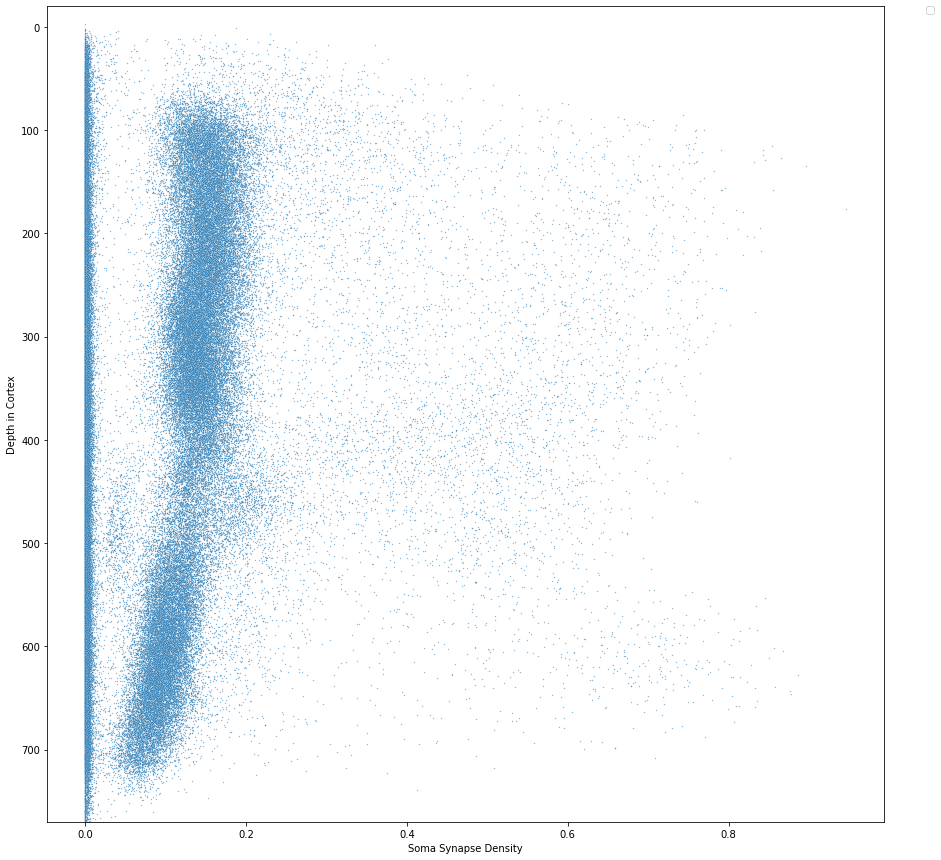

In [23]:
f,ax=plt.subplots(figsize=(15,15))
ax = sns.scatterplot(x='soma_syn_density_microns', y='transformed_y_nm', data=filtered_merged,
                     s=2, ax=ax, legend=False,alpha = 0.5)
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
#ax.set_xscale('log')
ax.set_xlabel('Soma Synapse Density')
ax.set_ylabel('Depth in Cortex')
#ax.set(xlim=(-.01,0.9))
ax.set(ylim=(-20,770))
ax.invert_yaxis()
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

In [24]:
filtered_merged['transformed_x_nm'] = [i[0] for i in filtered_merged.transformed_center_mass_nm]
filtered_merged['transformed_y_nm'] = [i[1] for i in filtered_merged.transformed_center_mass_nm]
filtered_merged['transformed_z_nm'] = [i[2] for i in filtered_merged.transformed_center_mass_nm]


filtered_merged['nucleus_x_nm'] = [i[0] for i in filtered_merged.nucleus_center_mass]
filtered_merged['nucleus_y_nm'] = [i[1] for i in filtered_merged.nucleus_center_mass]
filtered_merged['nucleus_z_nm'] = [i[2] for i in filtered_merged.nucleus_center_mass]

Plotting Nucleus Volumes Across the dataset using the newly transformed coordinates

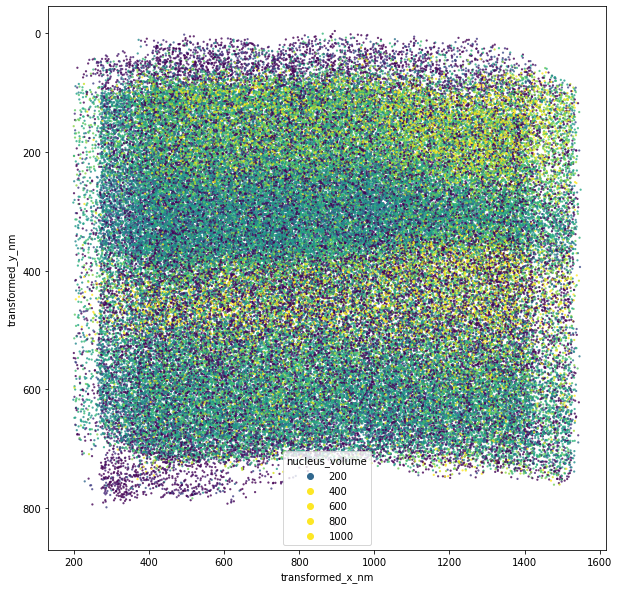

In [27]:
f, ax = plt.subplots(1,1,   figsize=(10,10))
sns.scatterplot(data=filtered_merged, x='transformed_x_nm',
 y='transformed_y_nm', hue='nucleus_volume', hue_norm=(100,400),
  palette=plt.cm.viridis, ax=ax, 
  s=5, linewidth=0, alpha=0.8)
plt.gca().invert_yaxis()

While the variations in nucleus volume in the XY plane are as expected (variable by cortical layer), in the XZ plane below (or the YZ) you can see shifts that correspond to chunks in Z. This is likely due to section thickness variability and other similar artifacts during sectioning. We addressed this by Z normalizing all the features (shown in the next sections).

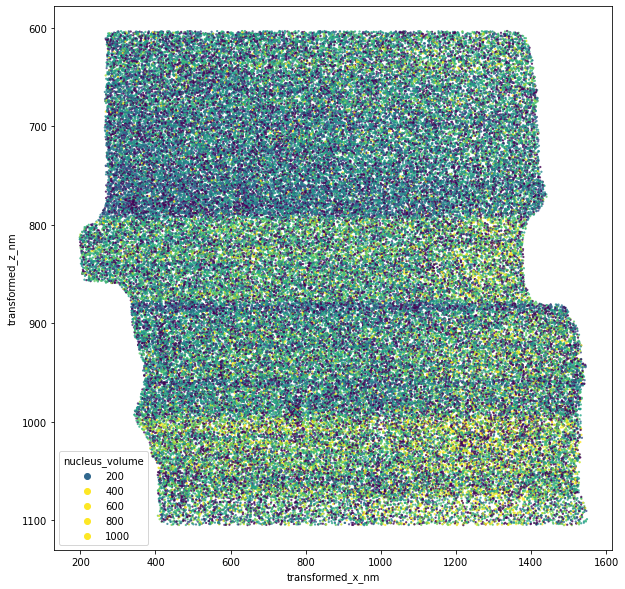

In [29]:
f, ax = plt.subplots(1,1,   figsize=(10,10))
sns.scatterplot(data=filtered_merged, x='transformed_x_nm',
 y='transformed_z_nm', hue='nucleus_volume', hue_norm=(100,400),
  palette=plt.cm.viridis, ax=ax, 
  s=5, linewidth=0, alpha=0.8)
plt.gca().invert_yaxis()


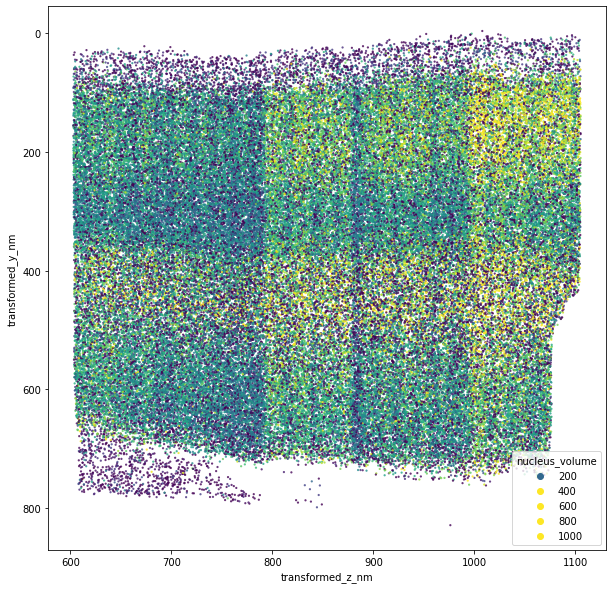

In [28]:
f, ax = plt.subplots(1,1,   figsize=(10,10))
sns.scatterplot(data=filtered_merged, x='transformed_z_nm',
 y='transformed_y_nm', hue='nucleus_volume', hue_norm=(100,400),
  palette=plt.cm.viridis, ax=ax, 
  s=5, linewidth=0, alpha=0.8)
plt.gca().invert_yaxis()


### Z Normalization

We chose to normalize Minnie 65 in Z using 20 section chunks (at resolution 40nm per section), these numbers should be adjusted per dataset

In [131]:
# bin the nucleus position in z and calculate the mean, median and standard deviation of the nucleus volume
# using scipy.stats.binned_statistic
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.binned_statistic.html


sections = 20
res = (sections*40)/1000
min_z = filtered_merged.transformed_z_nm.min()
max_z = filtered_merged.transformed_z_nm.max() 
    

((628,), (628,), (628,))

Example of Z normalization with one feature - nucleus volume

In [ ]:
#Calculating stats per chunk in Z
mean_vol=sp.stats.binned_statistic(filtered_merged.transformed_z_nm, filtered_merged.nucleus_volume,
 bins=np.arange(min_z, max_z,res), statistic='mean')
median_vol=sp.stats.binned_statistic(filtered_merged.transformed_z_nm, filtered_merged.nucleus_volume,
    bins=np.arange(min_z, max_z,res), statistic='median')
std_vol=sp.stats.binned_statistic(filtered_merged.transformed_z_nm, filtered_merged.nucleus_volume,
    bins=np.arange(min_z, max_z,res), statistic='std')

Below you can see how the nucleus volume is jumping by chunk in the Z plane

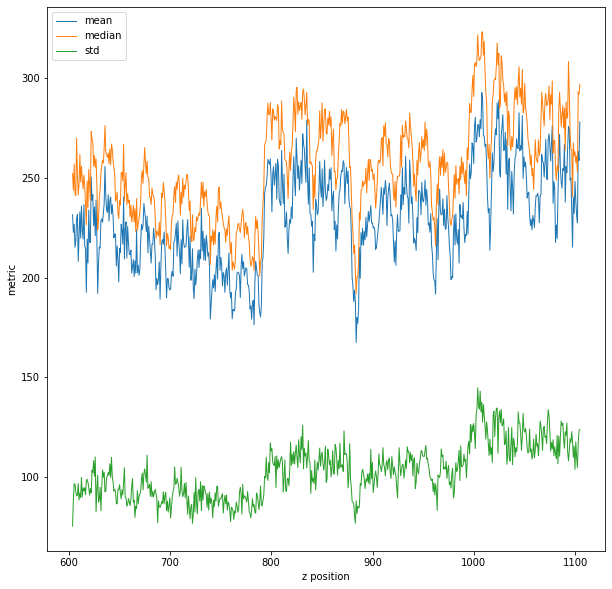

In [132]:
f, ax = plt.subplots(1,1, figsize=(10,10))
ax.plot(mean_vol.bin_edges[1:], mean_vol.statistic, '-', linewidth=1)
ax.plot(median_vol.bin_edges[1:], median_vol.statistic, '-', linewidth=1)
ax.plot(std_vol.bin_edges[1:], std_vol.statistic, '-', linewidth=1)
ax.set_xlabel('z position')
ax.set_ylabel('metric')
ax.legend(['mean', 'median', 'std'])

Normalize the nucleus volume by the mean volume at that z position

In [134]:
mean_vol_norm = median_vol.statistic/np.mean(median_vol.statistic)
filtered_merged['nucleus_volume_norm']=filtered_merged.nucleus_volume / mean_vol_norm[np.digitize(filtered_merged.transformed_z_nm, mean_vol.bin_edges)-2]


Below shows the plots before and after Z normalization - looks much better!

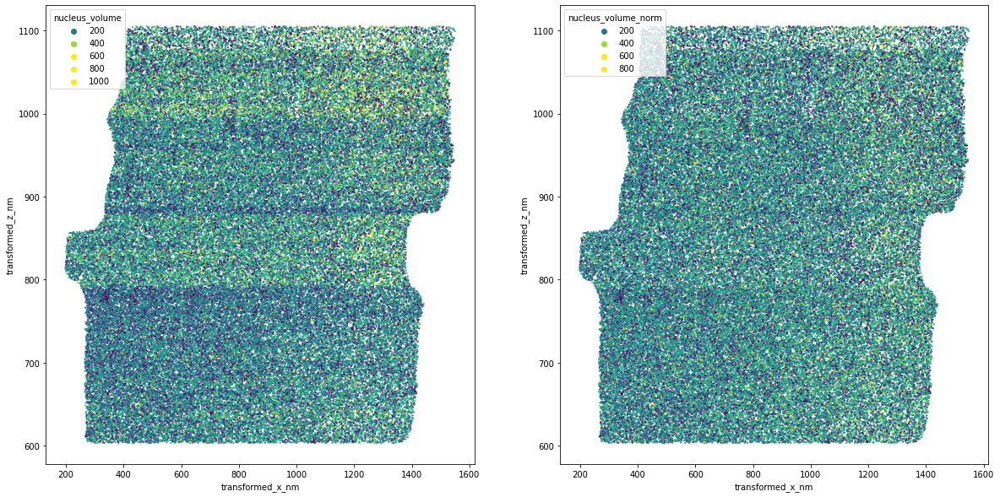

In [135]:
qs = np.percentile(filtered_merged['nucleus_volume'],[1,99])
qs = (qs[0],qs[1])

f, ax = plt.subplots(1,2,   figsize=(20,10))
sns.scatterplot(data=filtered_merged, x='transformed_x_nm',
 y='transformed_z_nm', hue='nucleus_volume', hue_norm=qs,#(100,400),
  palette=plt.cm.viridis, ax=ax[0], 
  s=5, linewidth=0, alpha=0.8)
plt.gca().invert_yaxis()

sns.scatterplot(data=filtered_merged, x='transformed_x_nm',
 y='transformed_z_nm', hue='nucleus_volume_norm',hue_norm=qs,#(100,400),
  palette=plt.cm.viridis, ax=ax[1], 
  s=5, linewidth=0, alpha=0.8)
plt.gca().invert_yaxis()

Text(0, 0.5, 'median nucleus volume')

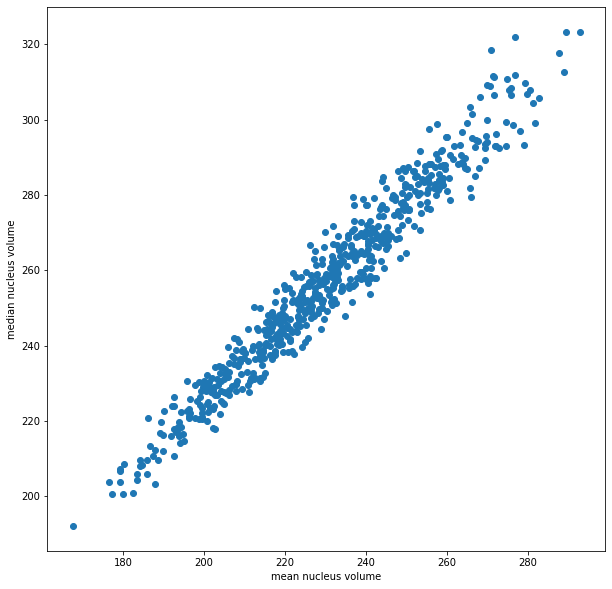

In [136]:
# make a scatter plot of the median vs mean values
f, ax = plt.subplots(1,1, figsize=(10,10))
ax.plot(mean_vol.statistic, median_vol.statistic, 'o', linewidth=1)
ax.set_xlabel('mean nucleus volume')
ax.set_ylabel('median nucleus volume')



Now that this works, below are a few functions to help run and visualize this normalization on any list of features in the dataframe

    

In [138]:
def get_z_profile_stats(df,column, z_coord, nbins=1000):
    '''A function to Z normalize a single column in a given dataframe'''
    min_z = df[z_coord].min()
    max_z = df[z_coord].max() 
    mean_vol=sp.stats.binned_statistic(df[z_coord], df[column],
     bins=np.arange(min_z, max_z,nbins), statistic='mean')
    median_vol=sp.stats.binned_statistic(df[z_coord], df[column],
        bins=np.arange(min_z, max_z,nbins), statistic='median')
    std_vol=sp.stats.binned_statistic(df[z_coord], df[column],
        bins=np.arange(min_z, max_z,nbins), statistic='std')
    return mean_vol, median_vol,std_vol


def z_normalize_each(df, z_column, columns, nbins=1000):
    '''Loops through a list of given features and Z normalizes the data from each feature separately.'''
    for c in columns:
        #calculate statistics for z for each feature separately
        mean_vol, median_vol, std_vol = get_z_profile_stats(df,c, z_column, nbins)
        mean_vol_norm = median_vol.statistic/np.mean(median_vol.statistic)

        soma_zbin = np.digitize(df[z_column], mean_vol.bin_edges)-1
        soma_zbin=np.clip(soma_zbin, 0, len(mean_vol_norm)-1)
        
        #apply normalization based on custom norm stats
        df['%s_norm'%(c)]=df[c]/ mean_vol_norm[soma_zbin]
    
    return df

def plot_z_profile_stat(df,column, z_coord, nbins=1000):

    min_z = df[z_coord].min()
    max_z = df[z_coord].max()
    bins = np.linspace(min_z, max_z, nbins)
    mean_vol=sp.stats.binned_statistic(df[z_coord], df[column],
    bins=bins, statistic='mean')
    median_vol=sp.stats.binned_statistic(df[z_coord], df[column],
        bins=bins, statistic='median')
    std_vol=sp.stats.binned_statistic(df[z_coord], df[column],
        bins=bins, statistic='std')
    
    f, ax = plt.subplots(1,1, figsize=(10,10))
    ax.plot(mean_vol.bin_edges[1:], mean_vol.statistic, '-', linewidth=1)
    ax.plot(median_vol.bin_edges[1:], median_vol.statistic, '-', linewidth=1)
    ax.plot(std_vol.bin_edges[1:], std_vol.statistic, '-', linewidth=1)
    ax.set_xlabel('z position')
    ax.set_ylabel('metric')
    ax.legend(['mean', 'median', 'std'])
    ax.set_title(column)

Run Z normalization on the given features on a copy of the dataframe 

In [139]:
#list of features to normalize
norm_features = ['nucleus_volume','nucleus_area','nucleus_area_to_volume_ratio','fold_area_nm',
 'fract_fold','nucleus_to_soma','soma_volume','soma_area','soma_nuc_d',
 'soma_area_to_volume','n_soma_syn','soma_syn_density_microns']

sections = 20
nbins = (sections*40)/1000 #same as the variable res above
norm_df_each = z_normalize_each(filtered_merged.copy(),'transformed_z_nm',norm_features,nbins=nbins)


Plotting examples before and after z normalization for individual features

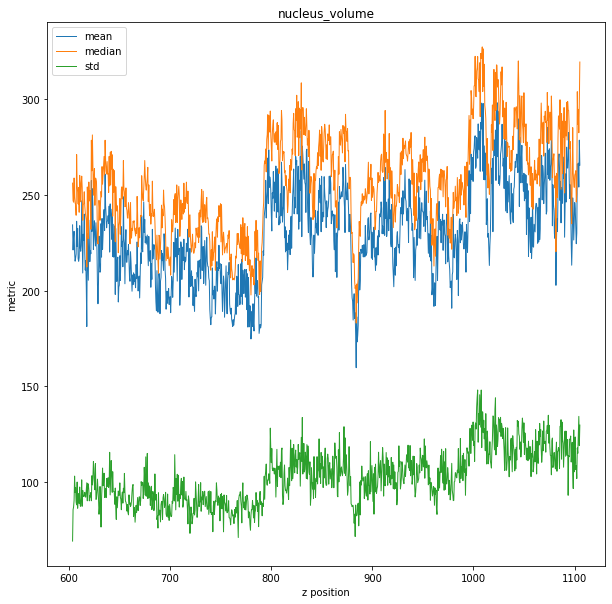

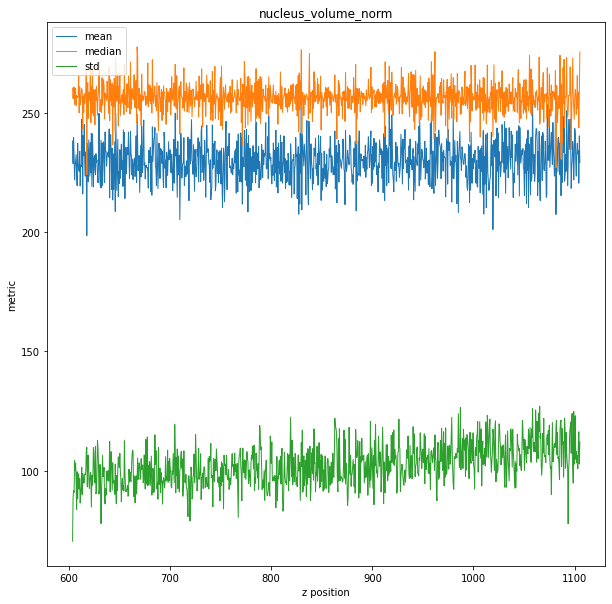

In [140]:
#Trace Plots
plot_z_profile_stat(norm_df_each,'nucleus_volume', 'transformed_z_nm')
plot_z_profile_stat(norm_df_each, 'nucleus_volume_norm', 'transformed_z_nm')

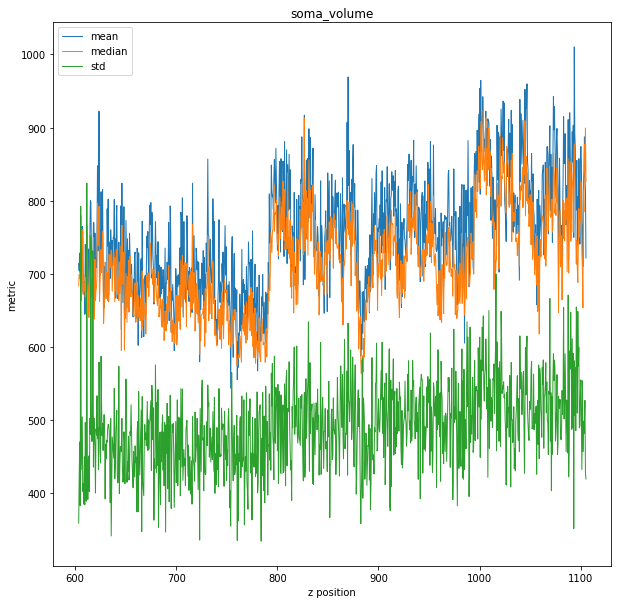

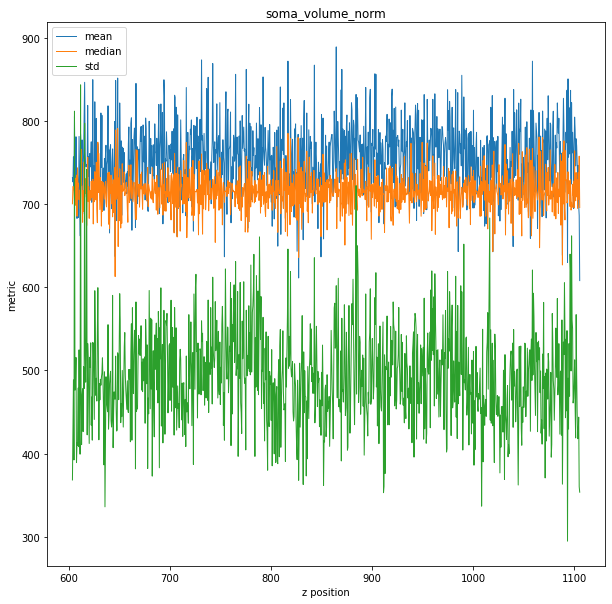

In [141]:
#Trace Plots
plot_z_profile_stat(norm_df_each,'soma_volume', 'transformed_z_nm')
plot_z_profile_stat(norm_df_each, 'soma_volume_norm', 'transformed_z_nm')

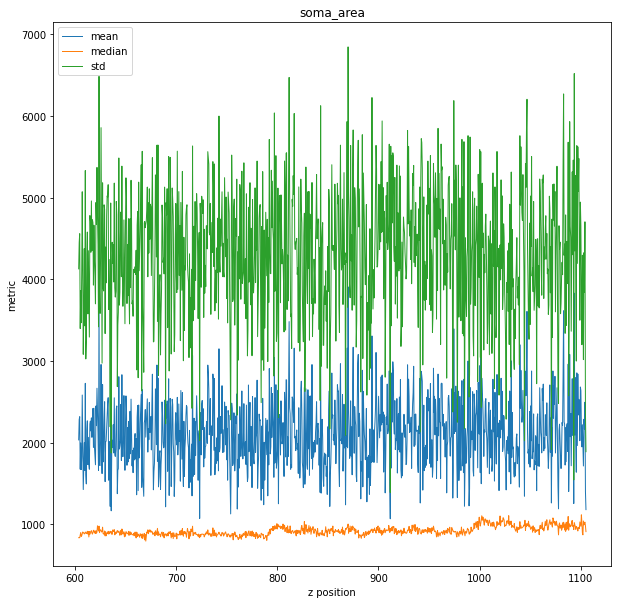

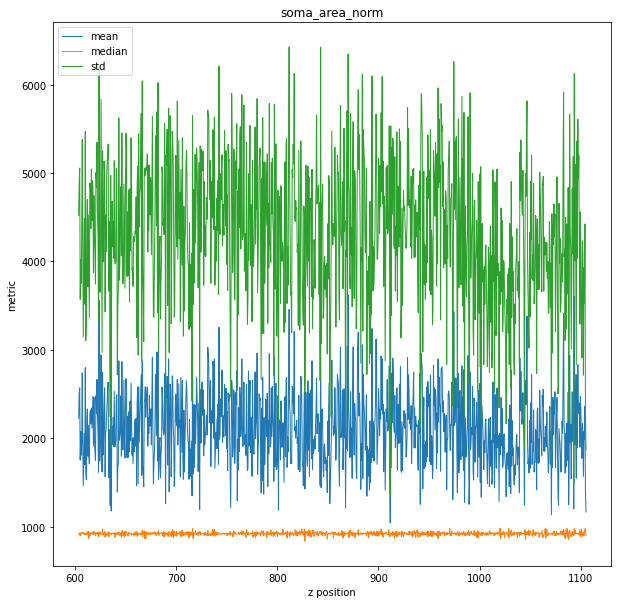

In [142]:
#Trace Plots
plot_z_profile_stat(norm_df_each,'soma_area', 'transformed_z_nm')
plot_z_profile_stat(norm_df_each, 'soma_area_norm', 'transformed_z_nm')

Figure(720x720)


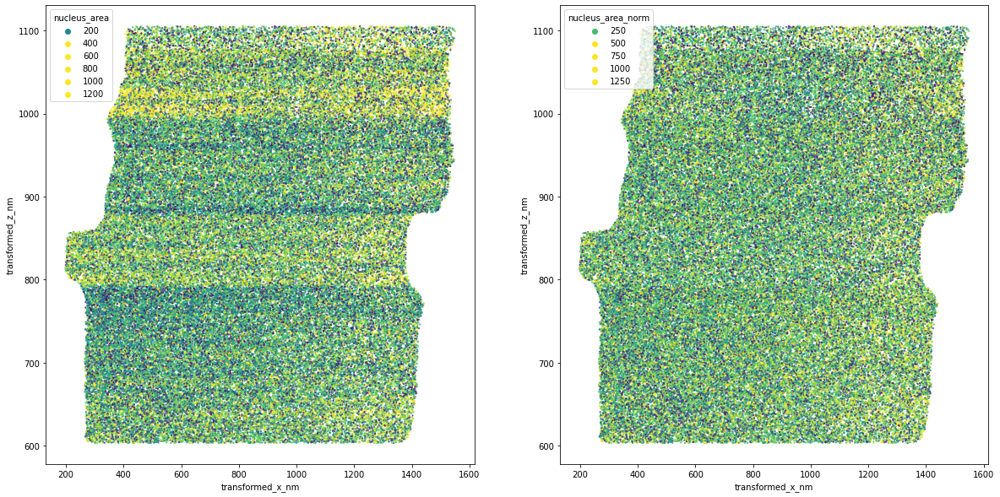

Figure(1440x720)


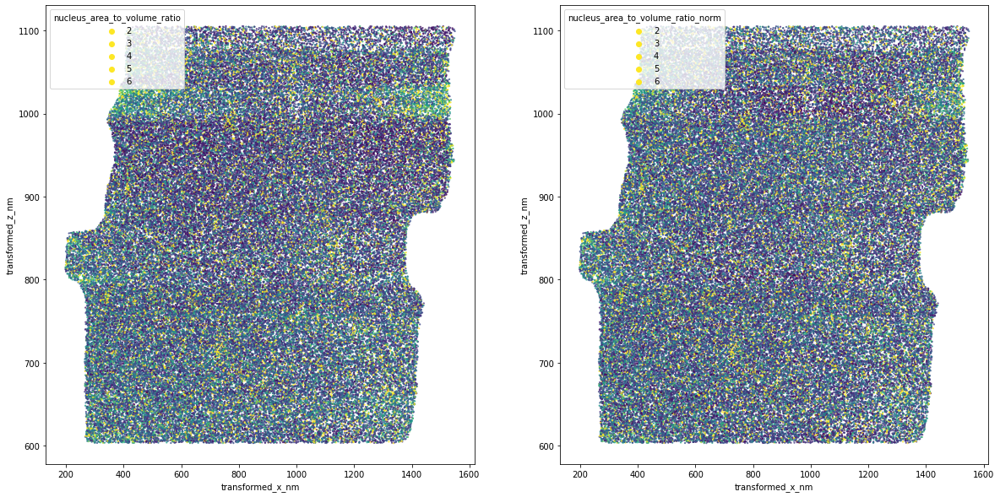

Figure(1440x720)


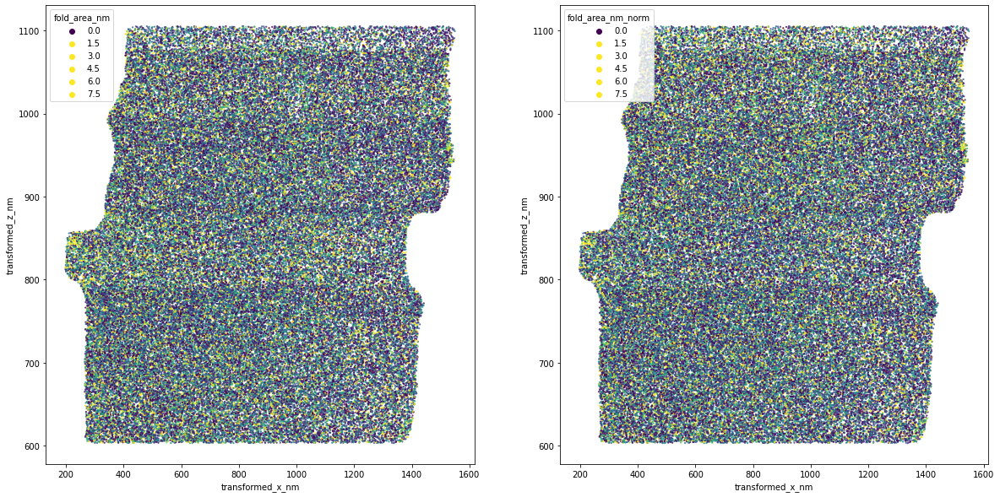

Figure(1440x720)


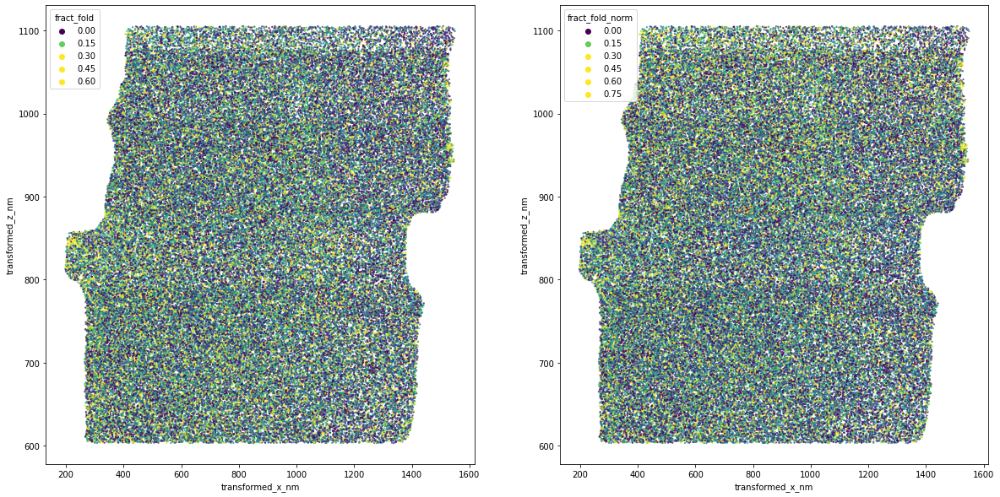

Figure(1440x720)


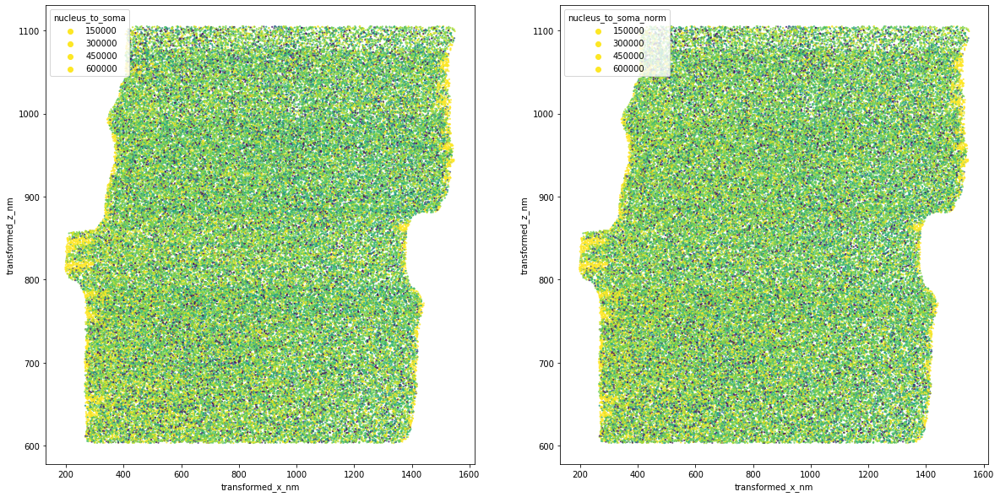

Figure(1440x720)


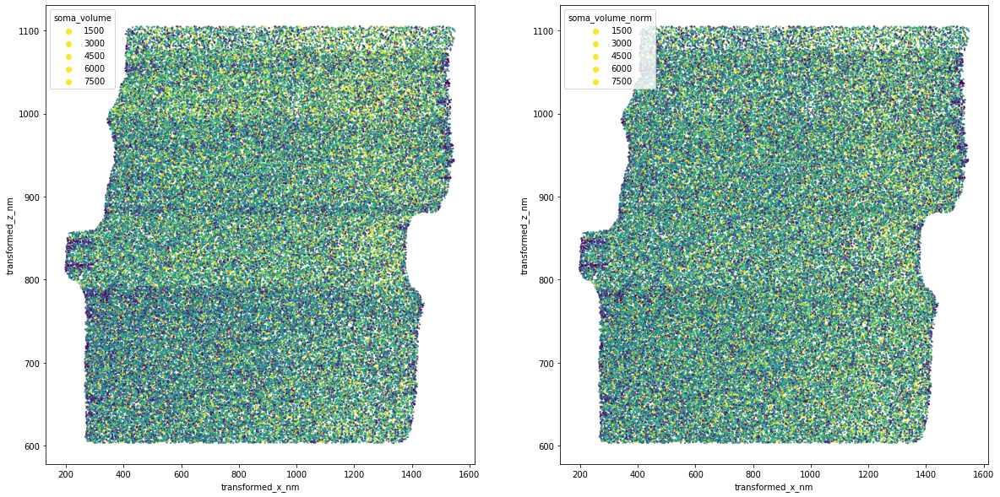

Figure(1440x720)


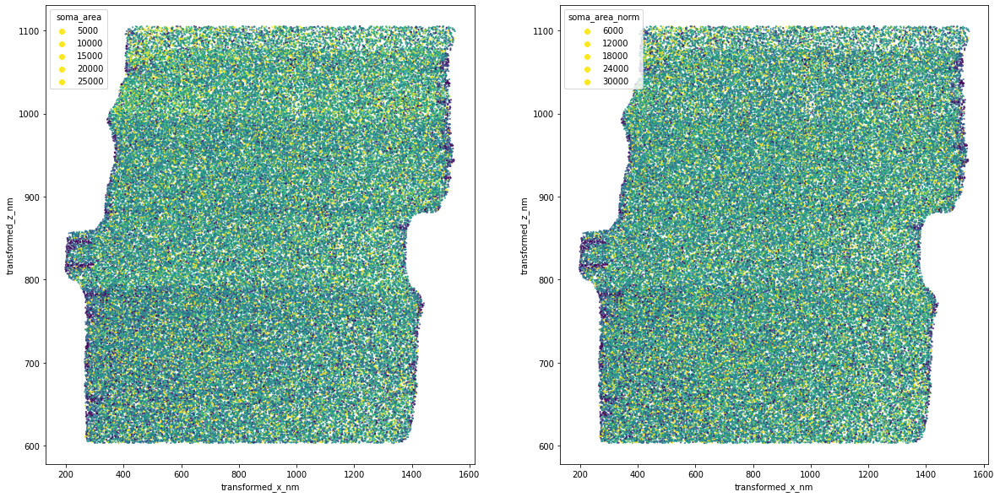

Figure(1440x720)


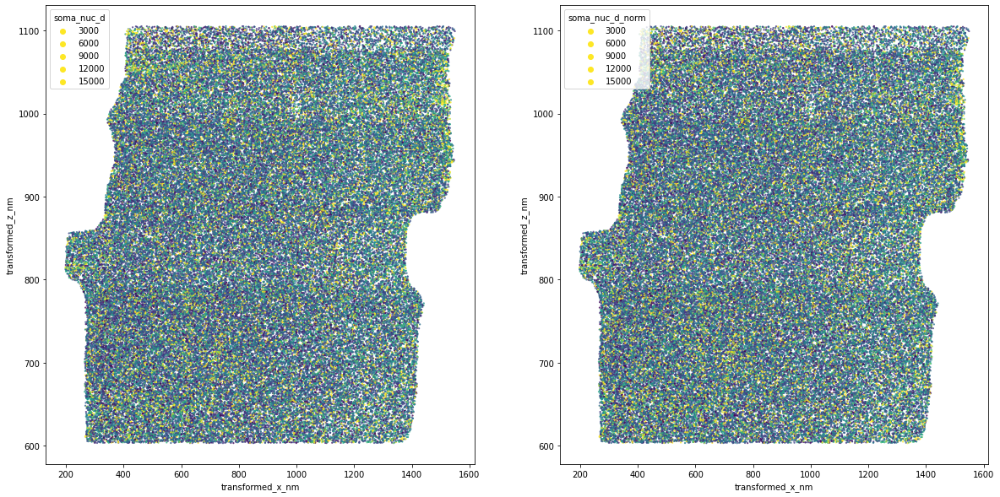

Figure(1440x720)


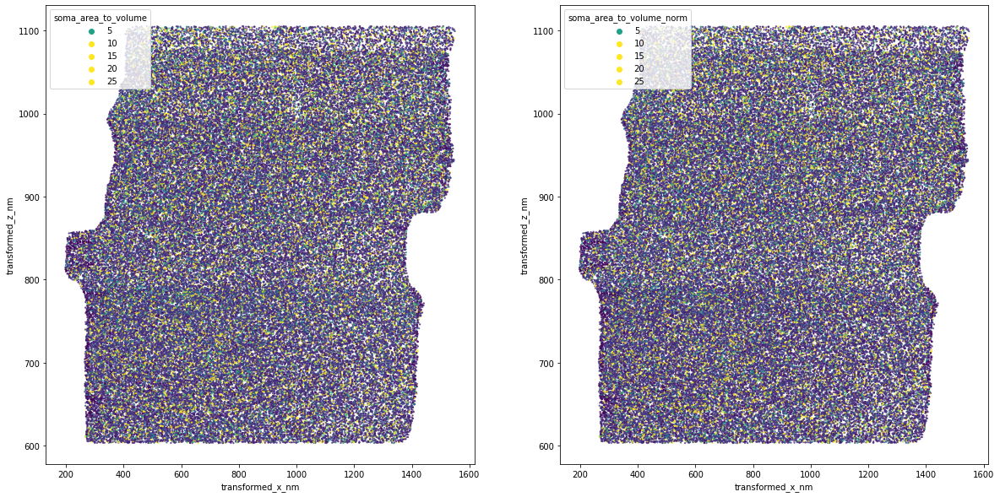

Figure(1440x720)


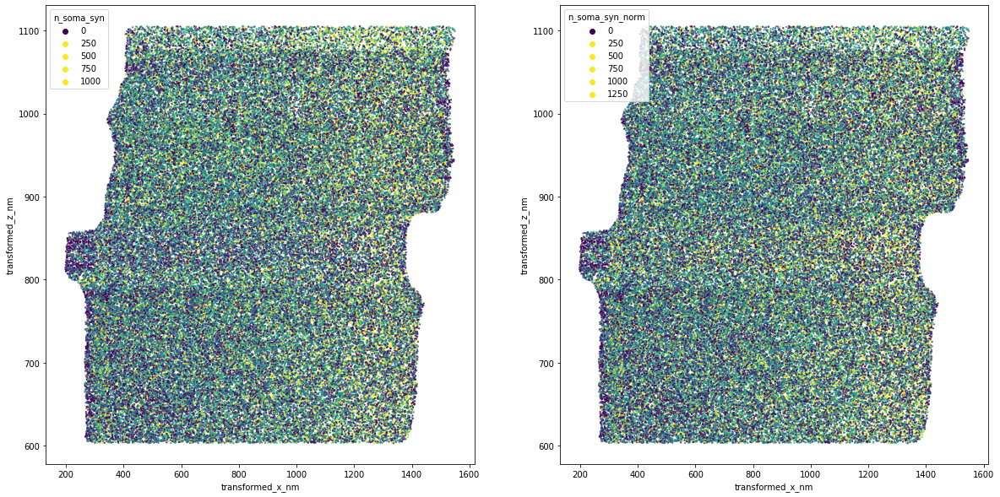

Figure(1440x720)


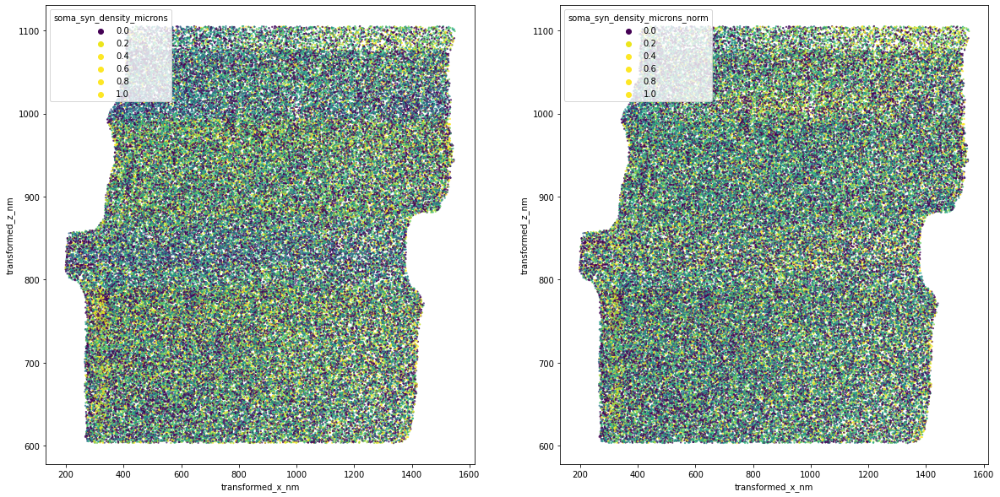

Figure(1440x720)


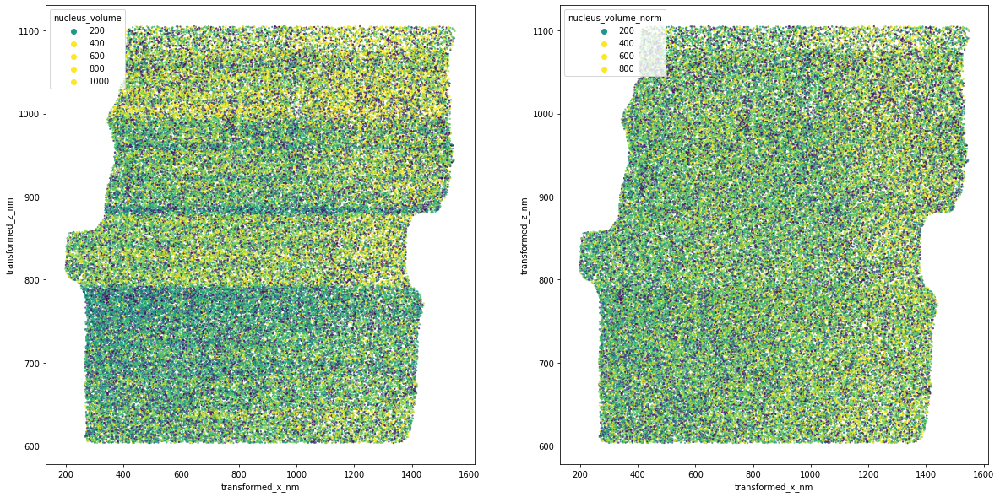

In [137]:
#XZ Scatter Plots
for feat in norm_features: 
    print(f)
    f, ax = plt.subplots(1,2, figsize=(20,10))
    qs = np.percentile(norm_df_each[feat],[1,90])
    qs = (qs[0],qs[1])
    
    norm_feat = '%s_norm'%(feat)
    sns.scatterplot(data=norm_df_each, x='transformed_x_nm',
        y='transformed_z_nm', hue=feat, hue_norm=qs,#(100,400),
        palette=plt.cm.viridis, ax=ax[0], 
        s=5, linewidth=0, alpha=0.8)
    plt.gca().invert_yaxis()

    sns.scatterplot(data=norm_df_each, x='transformed_x_nm',
        y='transformed_z_nm', hue=norm_feat, hue_norm=qs,#(100,400),
        palette=plt.cm.viridis, ax=ax[1], 
        s=5, linewidth=0, alpha=0.8)
    plt.gca().invert_yaxis()
    #plt.savefig('/Users/leilae/Documents/Mouse_connectomics/figures/ZNORM_EACH_%s_072723.png'%feat)
    plt.show()

### Z Normalized UMAP

We commonly used UMAP to visualize a 2D embedding of all the somatic features for QC, the embedding we used was on the Z normalized features and was added to the dataframe for consistency 

In [143]:
features = ['nucleus_area_norm',
 'nucleus_area_to_volume_ratio_norm',
 'fold_area_nm_norm',
 'fract_fold_norm',
 'nucleus_to_soma_norm',
 'nucleus_volume_norm',
 'transformed_y_nm',
 'soma_volume_norm',
 'soma_area_norm',
 'soma_nuc_d_norm',
 'soma_area_to_volume_norm',
 'n_soma_syn_norm',
 'soma_syn_density_microns_norm']

In [145]:
tform=umap.UMAP(random_state=5)


M=norm_df_each[features].fillna(0).values
print(M.shape)
Mz1=scipy.stats.zscore(M, axis=0)

Mt = tform.fit_transform(Mz1)

(106765, 13)


In [146]:
norm_df_each['umap_soma_znorm_x']=Mt[:,0]
norm_df_each['umap_soma_znorm_y']=Mt[:,1]

The coloring of the UMAP below used older cell-type predictions as a first pass, if this does not exist just alter the hue variable

In [147]:
labels = []
for i in norm_df_each.cell_type_model.tolist():
    if type(i) != str:
        labels.append('Unlabeled')
    else:
        labels.append(i)
norm_df_each['prelim_labels'] = labels

norm_df_each.prelim_labels.value_counts()

Unlabeled    20171
23P          19139
4P           13407
6P-IT        10746
5P-IT         9060
astrocyte     7403
6P-CT         5862
oligo         4998
BC            3084
microglia     3024
OPC           2483
MC            2270
5P-ET         1626
BPC           1424
pericyte       962
NGC            650
5P-NP          456
Name: prelim_labels, dtype: int64

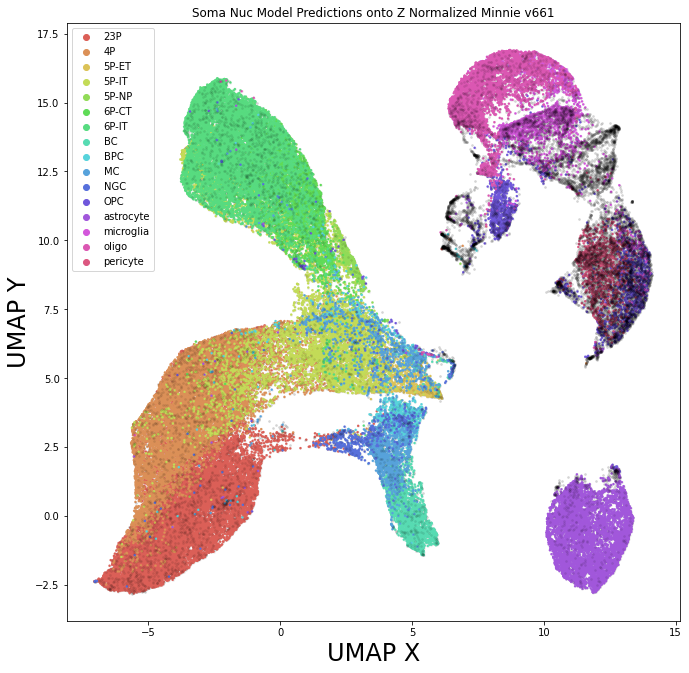

In [148]:
f, ax =plt.subplots(figsize=(11,11), facecolor='white')


sns.scatterplot( x='umap_soma_znorm_x', y='umap_soma_znorm_y', ax =ax, s=5, alpha=0.4, 
                edgecolor=None, data=norm_df_each, legend = True, color= 'lightgray')

sns.scatterplot( x='umap_soma_znorm_x', y='umap_soma_znorm_y', ax =ax, s=5, alpha=1, hue='cell_type_model',
                palette='hls', legend = True,
                c=(.2,.2,.2),edgecolor=None, data= norm_df_each.sort_values('cell_type_model'))

sns.scatterplot( x='umap_soma_znorm_x', y='umap_soma_znorm_y', ax =ax, s=5, alpha=.1, color='black',
                 legend = True,edgecolor=None, data= norm_df_each.query('prelim_labels == "Unlabeled"'))
ax.set_xlabel('UMAP X', fontsize=24)
ax.set_ylabel('UMAP Y', fontsize=24)
plt.title('Soma Nuc Model Predictions onto Z Normalized Minnie v661')

Don't forget to SAVE the df after all of this!

In [149]:
output_folder = './'
output_filename = 'ZNORM_filtered_minnie_v661_082823.pkl' #EXAMPLE NAME - Change this to match your dataset
output_filepath = os.path.join(output_folder,output_filename)
norm_df_each.to_pickle(output_filepath)